In [98]:
pip install matplotlib networkx

You should consider upgrading via the '/usr/local/bin/python3 -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


In [99]:
import math
import networkx as nx
from networkx.drawing.nx_pylab import draw_networkx_nodes, draw_networkx_edges, draw_networkx_edge_labels
from enum import Enum
import matplotlib.pyplot as plt
import numpy as np
import json

In [100]:
class Activation(Enum):
    """
    List of activation functions that can be used in the feedforward
    neural network
    """
    LINEAR  = 0
    SIGMOID = 1
    RELU    = 2
    SOFTMAX = 3

    @staticmethod
    def from_json(label):
        """
        This is what you get for giving a two day's notice
        """
        if ( label == 'linear'):
          return Activation.LINEAR
        elif (label == 'sigmoid'):
          return Activation.SIGMOID
        elif( label == 'relu'):
          return Activation.RELU
        elif ( label == 'softmax'):
          return Activation.SOFTMAX
        else:
          raise Exception("Invalid activation function")
        
    @staticmethod
    def to_json(activation):
        if ( activation == Activation.LINEAR):
          return 'linear'
        elif (activation == Activation.SIGMOID):
          return 'sigmoid'
        elif( activation == Activation.RELU):
          return 'relu'
        elif ( activation == Activation.SOFTMAX):
          return 'softmax'
        else:
          raise Exception("Invalid activation function")


In [101]:
import math
import numpy as np

def linear(x: float) -> float:
    return x

def sigmoid(x: float) -> float:
    return 1 / (1 + math.exp(-x))

def relu(x: float) -> float:
    return max(0, x)

def softmax(x : list[float]) -> list[float]:
    """Compute softmax values for each sets of scores in x."""
    max_x = max(x)
    x_exp = [np.exp(xi - max_x) for xi in x]
    # Compute the sum of the exponential values
    sum_x_exp = sum(x_exp)
    # Compute the softmax values
    softmax_x = [xi_exp / sum_x_exp for xi_exp in x_exp]
    return softmax_x

def linear_derivative(x: float) -> float:
    return 1

def sigmoid_derivative(x: float) -> float:
    return sigmoid(x) * (1 - sigmoid(x))

def relu_derivative(x: float) -> float:
    return 1 if x > 0 else 0

def softmax_derivative(target: list[float], output: list[float]) -> list[float]:
    """Compute the derivative of the softmax function with respect to input z."""

    # dE/dnet = pj if j != target class
    # dE/dnet = pj - 1 if j == target class

    result = []
    for output, target in zip(output, target):
        if target == 1.0:
            result.append(output - 1)
        else:   
            result.append(output)
    return result


In [102]:
def sse(target: list[float], predicted: list[float]) -> float:
    return 0.5 * sum((target[i] - predicted[i]) ** 2 for i in range(len(target)))

def cross_entropy_loss(y: int, p: list[float]) -> float:
    # y is the target (true) value
    # p is the predicted probability distribution
    # pk is the predicted probability of the true value y
    pk = p[y]
    # calculate the cross entropy loss
    E = -math.log(pk)
    return E


In [103]:
class Perceptron:
    """
    Perceptron class that takes in a list of weights and a bias,
    and returns the output of the perceptron using the net function
    """
    delta : float = 0.0

    def __init__(self, weights: list[float], bias: float, id : int, activation: Activation) -> None:
        self.weights: list[float] = weights
        self.bias   : float       = bias
        self.output : float       = 0.0
        self.delta  : float       = 0.0
        self.id    : int         = id
        self.type   : Activation  = activation

    def predict(self, inputs: list[float], type : Activation) -> float:
        """
        Net function that takes in a list of inputs and returns the output
        """
        print("len inputs", len(inputs))
        print("len weights", len(self.weights))
        print("weights", self.weights)
        print("input", inputs)
        assert len(inputs) == len(self.weights) # Guard against invalid input size
        z = sum([inputs[i] * self.weights[i] for i in range(len(inputs))]) + self.bias

        output = 0.0
        if (type == Activation.LINEAR):
            output = linear(z)
        elif (type == Activation.SIGMOID):
            output = sigmoid(z)
        elif (type == Activation.RELU):
            output = relu(z)
        elif (type == Activation.SOFTMAX):
            output = softmax(z)
        else:
            raise Exception("Invalid activation function")
        self.output = output

        return output

    def __str__ (self):
        return "Perceptron with weights " + str(self.weights) + " and bias " + str(self.bias) + " and output " + str(self.output)
        

    def net(self, inputs: list[float]) -> float:
        """
        Net function that takes in a list of inputs and returns the output
        """
        assert len(inputs) == len(self.weights) # Guard against invalid input size
        return sum([inputs[i] * self.weights[i] for i in range(len(inputs))]) + self.bias
    
    def activate (self, inputs: list[float], activation: Activation) -> float:


        result = 0.0

        if (activation == Activation.LINEAR):
            result = linear(self.net(inputs))
        elif (activation == Activation.SIGMOID):
            result = sigmoid(self.net(inputs))
        elif (activation == Activation.RELU):
            result = relu(self.net(inputs))
        elif (activation == Activation.SOFTMAX):
            result = softmax(self.net(inputs))
        else:
            raise Exception("Invalid activation function")
        
        self.output = result
        return result



    def activate_derivative (self, inputs):


        result = 0.0
        activation = self.type

        if (activation == Activation.LINEAR):
            result = linear_derivative(inputs)
        elif (activation == Activation.SIGMOID):
            result = sigmoid_derivative(inputs)
        elif (activation == Activation.RELU):
            result = relu_derivative(inputs)
        elif (activation == Activation.SOFTMAX):
            result = softmax_derivative(inputs)
        else:
            raise Exception("Invalid activation function")
        
        return result

    
    def visualize(self, pos: int = 0) -> None:
        """
        Visualizes the perceptron using Networkx
        """
        graph    = nx.DiGraph()
        position: dict[int, tuple[int, int]] = {key: (0, key) for key in range(len(self.weights))}
        position[-1] = (0, -1)
        labels  : dict[tuple[int, int], str] = {(key, len(self.weights)): str(round(self.weights[key], 2)) for key in position.keys()}
        labels[(-1, len(self.weights))] = str(round(self.bias, 2))
        position[len(self.weights)] = (1, pos)
        for key in position.keys():
            graph.add_node(key)
        for edge in labels.keys():
            graph.add_edge(*edge)
        draw_networkx_nodes(graph, position, nodelist=[-1], node_size=100, node_color="orangered")
        draw_networkx_nodes(graph, position, nodelist=list(range(len(self.weights))), node_size=100, node_color="royalblue")
        draw_networkx_nodes(graph, position, nodelist=[len(self.weights)], node_size=100, node_color="limegreen")
        draw_networkx_edges(graph, position)
        draw_networkx_edge_labels(graph, position, label_pos=0.9, edge_labels=labels, font_size=10, rotate=False)
        plt.text(0, len(self.weights) - 0.5, "Input", horizontalalignment="center", verticalalignment="center")
        plt.text(1, len(self.weights) - 0.5, "Output", horizontalalignment="center", verticalalignment="center")
        plt.show()

In [104]:
class Layer:
    """
    Layer class that takes in a list of perceptrons and returns
    the output of the layer based on the type of activation function
    """

    def __init__(self, type: Activation, perceptrons: list[Perceptron]) -> None:
        self.type       : Activation       = type
        self.perceptrons: list[Perceptron] = perceptrons

    def __str__(self) -> str:
        """
        Returns the string representation of the layer
        """
        return "\n".join([f"Perceptron {i}: {str(perceptron)}" for i, perceptron in enumerate(self.perceptrons)])
    
    def predict(self, inputs: list[float]) -> list[float]:
        """
        Returns the output of the layer based on the type of activation function
        """
        if self.type != Activation.SOFTMAX:
            return [perceptron.predict(inputs, self.type) for perceptron in self.perceptrons]

        else :
            # calculate softmax
            result = []
            net = [perceptron.net(inputs) for perceptron in self.perceptrons]
            result = softmax(net)
            # assign self.perceptrons.output to softmax
            for i in range(len(result)):
                self.perceptrons[i].output = result[i]

            # return self.perceptrons.output
            return result


    def visualize(self) -> None:
        """
        Visualizes the layer using Networkx
        """
        graph    = nx.DiGraph()
        inputs   = len(self.perceptrons[0].weights)
        outputs  = len(self.perceptrons)
        rangewb  = inputs + outputs
        input_layer : dict[int, tuple[int, int | float]] = {key + outputs: (0, key)                                    for key in range(inputs)}
        biases      : dict[int, tuple[int, int | float]] = {key          : (outputs - key, -1)                               for key in range(outputs)}
        output_layer: dict[int, tuple[int, int | float]] = {key + rangewb: (outputs + 1, key + (inputs - outputs) / 2) for key in range(outputs)}
        positions = {**input_layer, **biases, **output_layer}
        label_list: list[dict[tuple[int, int], str]] = []
        for output in output_layer.keys():
            label_list.append({(key, output): str(round(self.perceptrons[output - rangewb].weights[key - outputs], 2)) for key in input_layer.keys()})
        label_list.extend([{(output - rangewb, output): str(round(self.perceptrons[output - rangewb].bias, 2))} for output in output_layer.keys()])
        for key in positions.keys():
            graph.add_node(key)
        for labels in label_list:
            for edge in labels.keys():
                graph.add_edge(*edge)
        draw_networkx_nodes(graph, positions, nodelist=list(range(outputs))                               , node_size=100, node_color="orangered")
        draw_networkx_nodes(graph, positions, nodelist=list(range(outputs         , inputs + outputs))    , node_size=100, node_color="royalblue")
        draw_networkx_edges(graph, positions, alpha=0.3)
        color_list = ["tab:blue", "tab:orange", "tab:green", "tab:red", "tab:purple", "tab:brown", "tab:pink", "tab:gray", "tab:olive", "tab:cyan"]
        x, y = list(label_list[-outputs])[0]
        vx, vy = positions[x], positions[y]
        min_dist = math.sqrt((vx[0] - vy[0]) ** 2 + (vx[1] - vy[1]) ** 2) / 2
        for i, weight, bias in zip(range(outputs), label_list[:-outputs], label_list[outputs:]):
            pos_w = 0.075 * (outputs - i) % 8 + 0.325
            x, y = list(bias.keys())[0]
            vx, vy = positions[x], positions[y]
            dist = math.sqrt((vx[0] - vy[0]) ** 2 + (vx[1] - vy[1]) ** 2)
            pos_b = 1 - min_dist / dist
            bbx = {"boxstyle": "round", "fc": color_list[i % 10], "ec": color_list[i % 10]}
            draw_networkx_nodes(graph, positions, nodelist=[inputs + outputs + i], node_size=100, node_color=color_list[i % 10])
            draw_networkx_edge_labels(graph, positions, bbox=bbx, label_pos=pos_w, edge_labels=weight, font_size=8, rotate=False)
            draw_networkx_edge_labels(graph, positions, bbox=bbx, label_pos=pos_b, edge_labels=bias, font_size=8, rotate=False)
        plt.text(0, max(inputs, outputs), "Input", horizontalalignment="center", verticalalignment="center")
        plt.text(outputs + 1, max(inputs, outputs), "Output", horizontalalignment="center", verticalalignment="center")
        plt.show()

In [105]:
# import random
import random


In [126]:
class FFNN:
    """
    Feedforward neural network class that can take in a list of
    layers from a text file
    """


    def __init__(self) -> None:
        self.layers : list[Layer] = []
        self.input_size : int = 0
        self.target : list[list[float]] = []
        self.learning_rate : float = 0.0
        self.batch_size : int = 0
        self.max_iteration : int = 0
        self.error_threshold : float = 0.0
        self.error : float = 0.0
        self.iteration : int = 0
        self.stopped_by : str = ""
        self.final_weights : list[list[list[float]]] = []

    def set_parameters(self, input_size: int, target: list[list[float]], learning_rate: float, batch_size: int, max_iteration: int, stopped_by : str ,error_threshold: float) -> None:
        self.input_size = input_size
        self.target = target
        self.learning_rate = learning_rate
        self.batch_size = batch_size
        self.max_iteration = max_iteration
        self.error_threshold = error_threshold
        self.stopped_by = stopped_by

    def set_inputs (self, inputs: list[list[float]]) -> None:
        self.inputs = inputs
    
    def set_target (self, target: list[list[float]]) -> None:
        self.target = target
        

    def add_layer(self, num_perceptrons: int, activation: str) -> None:
    # create list of perceptrons with random weights
        perceptrons = []
        id = 0
        for i in range(num_perceptrons):
            perceptrons.append(Perceptron([], 0, id, Activation.from_json(activation)))
            id += 1

        self.layers.append(Layer(Activation.from_json(activation), perceptrons))

        # initialize weights and biases
        if len(self.layers) > 1:
            num_of_prev_perceptrons = len(self.layers[-2].perceptrons)
            print("num_of_prev_perceptrons: ", num_of_prev_perceptrons)
            layer = self.layers[-1]
            for perceptron in layer.perceptrons:
                weights = []
                for _ in range(num_of_prev_perceptrons):
                    weights.append(random.uniform(-1, 1))
                perceptron.weights = weights
                perceptron.bias = random.uniform(-1, 1)
            print("weights: ", [perceptron.weights for perceptron in layer.perceptrons])
        else:
            num = self.input_size
            print("num: ", num)
            layer = self.layers[-1]
            for perceptron in layer.perceptrons:
                weights = []
                for _ in range(num):
                    weights.append(random.uniform(-1, 1))
                perceptron.weights = weights
                perceptron.bias = random.uniform(-1, 1)
            print("weights: ", [perceptron.weights for perceptron in layer.perceptrons])
                






    def _read(self, filename: str) -> None:
        with open(filename, 'r') as file:
            lines  = file.read().split('\n')
            config = lines[0].split(' ')
            self.depth : int         = int(config[0])
            self.inputs: int         = int(config[1])
            self.layers: list[Layer] = []
            i = 1
            prevdepth = self.inputs
            while i < len(lines):
                line        = lines[i].split(' ')
                layertype   = int(line[0])
                layerdepth  = int(line[1])
                perceptrons = []
                i += 1
                for _ in range(layerdepth):
                    values = lines[i].split(' ')
                    weights = [float(weight) for weight in values[:-1]]
                    assert len(weights) == prevdepth # Guard against invalid weight size
                    bias = float(values[-1])
                    perceptrons.append(Perceptron(weights, bias))
                    i += 1
                self.layers.append(Layer(Activation(layertype), perceptrons))
                prevdepth = layerdepth
            assert len(self.layers) + 1 == self.depth # Guard against invalid depth

    def __repr__(self) -> str:
        builder = ""
        builder += f"{self.depth} {self.inputs}\n"
        for layer in self.layers:
            builder += f"{layer.type.value} {len(layer.perceptrons)}\n"
            for perceptron in layer.perceptrons:
                builder += f"{' '.join([str(weight) for weight in perceptron.weights])} {perceptron.bias}\n"
        return builder

    def __str__(self) -> str:
        return f"{self.name}\n" + self.__repr__()
    
    def printNetwork (self) -> None:
        for layer in self.layers:
            print(layer)

    def load_network_from_json(self, filename: str) -> None:
        """
        Loads a network from a JSON file
        """
        data = json.load(open(filename))

        # extract case data
        case = data['case']
        model = case['model']
        self.inputs = case['input']
        initial_weights = case['initial_weights']
        self.initial_weight = initial_weights 
        self.target = case['target']
        learning_parameters = case['learning_parameters']

        # extract model data
        self.input_size = model['input_size']
        layers = model['layers']

        # extract learning parameters
        self.learning_rate = learning_parameters['learning_rate']
        self.batch_size = learning_parameters['batch_size']
        self.max_iteration = learning_parameters['max_iteration']
        self.error_threshold = learning_parameters['error_threshold']

        # extract expected output
        expect = data['expect']
        self.stopped_by = expect['stopped_by']
        self.final_weights = expect['final_weights'] if 'final_weights' in expect else None


        # extract layers
        for layer_idx, layer in enumerate(layers):
            activation_function = Activation.from_json(layer['activation_function'])

            perceptrons = []
            id = 0
            for i in range(layer['number_of_neurons']):
                # extract biases for current perceptron
                bias = initial_weights[layer_idx][0][i]

                  # extract weights for current perceptron
                weights = []
                for j in range(len(initial_weights[layer_idx])-1):
                    weights.append(initial_weights[layer_idx][j+1][i])

                # create a perceptron with weights and bias
                perceptron = Perceptron(weights, bias, id, activation_function)
                id += 1

                perceptrons.append(perceptron)

            # create layer with perceptrons
            self.layers.append(Layer(activation_function, perceptrons))

        # print the model
        # reset all atributtes

       
    def predict(self) -> list[float]:
        """
        Returns the output of the FFNN given the input
        """
        
        for pred, expect in zip(self.inputs, self.target) :
            nextinputs = pred
            for layer in self.layers:
                nextinputs = layer.predict(nextinputs)
                
        return nextinputs
    

    def train(self) -> None :
        # max iteration
        for i in range(self.max_iteration):
            # divide data into batches
            batches = [self.inputs[x:x+self.batch_size] for x in range(0, len(self.inputs), self.batch_size)]


            # divide target into batches
            batches_target = [self.target[x:x+self.batch_size] for x in range(0, len(self.target), self.batch_size)]

            print("Iteration : ", i + 1)
            total_error = 0.0

            # train each batch
            for batch, batch_target in zip(batches, batches_target):
                # initialize gradients of weights and bias for each batch
                delta_weights = []
                delta_bias = []
                print("Batch : ", batch)


                for layer in self.layers:
                    # Initialize the delta weights for this layer
                    weights_shape = (len(layer.perceptrons[0].weights), len(layer.perceptrons))
                    delta_weights_layer = [[0.0] * weights_shape[0] for _ in range(weights_shape[1])]
                    delta_weights.append(delta_weights_layer)

                    # Initialize the delta biases for this layer
                    delta_biases_layer = [0.0] * len(layer.perceptrons)
                    delta_bias.append(delta_biases_layer)

              
                # train each input
                for pred, expect in zip(batch, batch_target):
                    # forward pass sampe sini bener
                    nextinputs = pred
                    for layer in self.layers:
                        nextinputs = layer.predict(nextinputs)

                    print("Prediction of input: ", pred, " = ",nextinputs)


                    # compute error for output layer
                    error = 0
                   
                    if (self.layers[-1].type == Activation.SOFTMAX):
                        for output, target in zip(nextinputs, expect):
                            error += -target * math.log(output)
                        
                    else :
                        for output, target in zip(nextinputs, expect):
                            error += (output - target)**2
                        error /= 2

                    total_error += error

                  
                    # Compute delta for output layer
                    if (self.layers[-1].type == Activation.SOFTMAX):
                        # get list of output of perceptrons in output layer
                        outputs = [perceptron.output for perceptron in self.layers[-1].perceptrons]
                        delta = softmax_derivative(expect, outputs)
                        # assign delta to each perceptron in output layer
                        for i, perceptron in enumerate(self.layers[-1].perceptrons):
                            perceptron.delta = delta[i]


                        # update delta weights and delta bias for output layer
                        for i, perceptron in enumerate(self.layers[-1].perceptrons):
                            if (len(self.layers) == 1):
                                for j in range (len(perceptron.weights)):
                                    delta_weights[-1][i][j] += perceptron.delta * pred[j]

                            else :
                                for j in range (len(perceptron.weights)):
                                    delta_weights[-1][i][j] += perceptron.delta * self.layers[-2].perceptrons[j].output

                            delta_bias[-1][i] += perceptron.delta

                    else :
                        for i, perceptron in enumerate(self.layers[-1].perceptrons):
                            delta = (perceptron.output - expect[i]) * perceptron.activate_derivative(perceptron.output)
                                
                            perceptron.delta = delta


                            if (len(self.layers) == 1):
                                for j in range (len(perceptron.weights)):
                                    delta_weights[-1][i][j] += delta * pred[j]


                            else :
                                for j in range (len(perceptron.weights)):
                                    delta_weights[-1][i][j] += delta * self.layers[-2].perceptrons[j].output

                            delta_bias[-1][i] += delta

                    # Compute delta for hidden layers
                    for l in range(len(self.layers) - 2, -1, -1):
                        for i, perceptron in enumerate(self.layers[l].perceptrons):
                            delta = 0
                            for next_perceptron in self.layers[l + 1].perceptrons:
                                delta += next_perceptron.delta * next_perceptron.weights[i]
                            delta *= perceptron.activate_derivative(perceptron.output)
                            perceptron.delta = delta

                            # update delta weights and bias
                            if (l == 0):
                                for j in range(len(perceptron.weights)):
                                    delta_weights[l][i][j] += delta * pred[j]
                                delta_bias[l][i] += delta
                                
                            else :
                                for j in range(len(perceptron.weights)):
                                    delta_weights[l][i][j] += delta * self.layers[l - 1].perceptrons[j].output
                                delta_bias[l][i] += delta 

            

                # Update weights and bias mean per batch siz
                for l in range(len(self.layers)):
                    for i, perceptron in enumerate(self.layers[l].perceptrons):
                        for j in range(len(perceptron.weights)):
                            perceptron.weights[j] -= self.learning_rate * delta_weights[l][i][j]
                        perceptron.bias -= self.learning_rate * delta_bias[l][i] 

            
            # if error is small enough, stop training
            print("Total error = ", total_error, "treshold = ", self.error_threshold)
            if (total_error < self.error_threshold and self.stopped_by == "error_threshold"):
                print("Total error = ", total_error, " < ", self.error_threshold, " stop training")
                return


    def save_network_to_json(self, filename: str) -> None:
        """
        Saves the network to a JSON file
        """
        initial_weights = []

        for layer in self.layers:
            layer_weights = []

            # Append biases of all perceptrons in the current layer to the layer_weights list
            biases = [perceptron.bias for perceptron in layer.perceptrons]
            layer_weights.append(biases)

            # Append the weights for each perceptron to the subsequent rows of layer_weights
            for weight in layer.perceptrons[0].weights:
                layer_weights.append([perceptron.weights[layer.perceptrons[0].weights.index(weight)] for perceptron in layer.perceptrons])

            initial_weights.append(layer_weights)
            
        data = {
            'case': {
                'model': {
                    'input_size': self.input_size,
                    'layers': [
                        {
                            'number_of_neurons': len(layer.perceptrons),
                            'activation_function': Activation.to_json(layer.type)
                        } for layer in self.layers
                    ]
                },
                'input': self.inputs,
                'initial_weights': initial_weights,
                'target': self.target,
                'learning_parameters': {
                    'learning_rate': self.learning_rate,
                    'batch_size': self.batch_size,
                    'max_iteration': self.max_iteration,
                    'error_threshold': self.error_threshold
                }
            },
            'expect': {
                'stopped_by': self.stopped_by,
                'final_weights': self.final_weights
            }
        }
        # save to json file with title filename + _saved.json
        

        json.dump(data, open(filename, 'w'), indent=4)

    
    def visualize(self) -> None:
        """
        Visualizes the FFNN using Networkx
        """
        graph = nx.DiGraph()
        maxheight   = max([len(layer.perceptrons) for layer in self.layers])
        prev_range  = 0
        prev_maxpos = 0
        positions   = {}
        prev_output = {}
        for idx, layer in enumerate(self.layers):
            inputs  = len(layer.perceptrons[0].weights)
            outputs = len(layer.perceptrons)
            rangewb = inputs + outputs
            if idx == 0:
                input_layer: dict[int, tuple[int, int | float]] = {key: (0, key + (maxheight - inputs) / 2) for key in range(inputs)}
            else:
                input_layer: dict[int, tuple[int, int | float]] = prev_output
            biases         : dict[int, tuple[int, int | float]] = {key + inputs + prev_range : (outputs - key + prev_maxpos, -1) for key in range(outputs)}
            output_layer   : dict[int, tuple[int, int | float]] = {key + rangewb + prev_range: (outputs + 1 + prev_maxpos, key + (maxheight - outputs) / 2) for key in range(outputs)}
            positions = {**input_layer, **biases, **output_layer}
            label_list: list[dict[tuple[int, int], str]] = []
            for output in output_layer.keys():
                label_list.append({(key, output): str(round(layer.perceptrons[output - rangewb - prev_range].weights[key - prev_range], 2)) for key in input_layer.keys()})
            label_list.extend([{(output - outputs, output): str(round(layer.perceptrons[output - rangewb - prev_range].bias, 2))} for output in output_layer.keys()])
            if idx == 0:
                for key in positions.keys():
                    graph.add_node(key)
            else:
                for key in (biases | output_layer).keys():
                    graph.add_node(key)
            edgelist = []
            for labels in label_list:
                for edge in labels.keys():
                    graph.add_edge(*edge)
                    edgelist.append(edge)
            draw_networkx_nodes(graph, positions, nodelist=list(range(inputs + prev_range, rangewb + prev_range)), node_size=100, node_color="orangered")
            if idx == 0:
                draw_networkx_nodes(graph, positions, nodelist=list(range(prev_range, inputs + prev_range)), node_size=100, node_color="royalblue")
            draw_networkx_edges(graph, positions, edgelist=edgelist, alpha=0.3)
            color_list = ["tab:orange", "tab:green", "tab:red", "tab:blue", "tab:purple", "tab:brown", "tab:pink", "tab:gray", "tab:olive", "tab:cyan"]
            x, y = list(label_list[-outputs])[0]
            vx, vy = positions[x], positions[y]
            min_dist = math.sqrt((vx[0] - vy[0]) ** 2 + (vx[1] - vy[1]) ** 2) / 2
            for i, weight, bias in zip(range(outputs), label_list[:-outputs], label_list[outputs:]):
                pos_w = 0.075 * (outputs - i) % 8 + 0.25
                x, y = list(bias.keys())[0]
                vx, vy = positions[x], positions[y]
                dist = math.sqrt((vx[0] - vy[0]) ** 2 + (vx[1] - vy[1]) ** 2)
                pos_b = 1 - min_dist / dist
                bbx = {"boxstyle": "round","fc": "limegreen" if ((idx + 1) == len(self.layers)) else color_list[idx % 10], "ec": "limegreen" if ((idx + 1) == len(self.layers)) else color_list[idx % 10]}
                draw_networkx_nodes(graph, positions, nodelist=[inputs + outputs + i + prev_range], node_size=100, node_color="limegreen" if ((idx + 1) == len(self.layers)) else color_list[idx % 10])
                draw_networkx_edge_labels(graph, positions, bbox=bbx, label_pos=pos_w, edge_labels=weight, font_size=6, rotate=False)
                draw_networkx_edge_labels(graph, positions, bbox=bbx, label_pos=pos_b, edge_labels=bias, font_size=6, rotate=False)
            maxheight = max(maxheight, inputs, outputs)
            prev_range += rangewb
            prev_maxpos += outputs + 1
            prev_output = output_layer
        draw_networkx_nodes(graph, {-1: (0, maxheight)}, nodelist=[-1], node_size=100, node_color="none")
        plt.text(0, maxheight, "Input", horizontalalignment="center", verticalalignment="center")
        plt.text(list(positions.values())[-1][0], maxheight, "Output", horizontalalignment="center", verticalalignment="center")
        plt.show()

# Usage
## testcase dari asisten :v

Iteration :  1
Batch :  [[3.0, 1.0], [1.0, 2.0]]
len inputs 2
len weights 2
weights [0.4, 0.1]
input [3.0, 1.0]
len inputs 2
len weights 2
weights [0.2, -0.8]
input [3.0, 1.0]
len inputs 2
len weights 2
weights [-0.7, 0.5]
input [3.0, 1.0]
Prediction of input:  [3.0, 1.0]  =  [1.4000000000000004, 0.10000000000000003, -1.3999999999999997]
len inputs 2
len weights 2
weights [0.4, 0.1]
input [1.0, 2.0]
len inputs 2
len weights 2
weights [0.2, -0.8]
input [1.0, 2.0]
len inputs 2
len weights 2
weights [-0.7, 0.5]
input [1.0, 2.0]
Prediction of input:  [1.0, 2.0]  =  [0.7000000000000001, -1.1, 0.5]
Total error =  0.665 treshold =  0.0


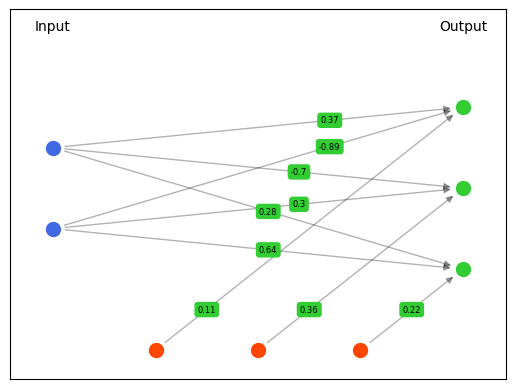

Expected final weights [[[0.22, 0.36, 0.11], [0.64, 0.3, -0.89], [0.28, -0.7, 0.37]]]
Final weights
[[[0.21999999999999997, 0.36, 0.10999999999999999], [0.6399999999999999, 0.30000000000000004, -0.89], [0.27999999999999997, -0.7, 0.37]]]
Sama dengan expected


In [107]:
# LINEAR.JSON
# example
back = FFNN()
back.load_network_from_json("linear.json")
back.train()
back.visualize()
print("Expected final weights", back.final_weights)

# print all weights and biass
print("Final weights")
final_weights = []

for layer in back.layers:
    layer_weights = []

    # Append biases of all perceptrons in the current layer to the layer_weights list
    biases = [perceptron.bias for perceptron in layer.perceptrons]
    layer_weights.append(biases)

    # Append the weights for each perceptron to the subsequent rows of layer_weights
    for weight in layer.perceptrons[0].weights:
        layer_weights.append([perceptron.weights[layer.perceptrons[0].weights.index(weight)] for perceptron in layer.perceptrons])

    final_weights.append(layer_weights)
print(final_weights)
print("Sama dengan expected")
del back


Iteration :  1
Batch :  [[3.0, 1.0], [1.0, 2.0]]
len inputs 2
len weights 2
weights [0.4, 0.1]
input [3.0, 1.0]
len inputs 2
len weights 2
weights [0.2, -0.8]
input [3.0, 1.0]
len inputs 2
len weights 2
weights [-0.7, 0.5]
input [3.0, 1.0]
Prediction of input:  [3.0, 1.0]  =  [1.4000000000000004, 0.10000000000000003, -1.3999999999999997]
len inputs 2
len weights 2
weights [0.4, 0.1]
input [1.0, 2.0]
len inputs 2
len weights 2
weights [0.2, -0.8]
input [1.0, 2.0]
len inputs 2
len weights 2
weights [-0.7, 0.5]
input [1.0, 2.0]
Prediction of input:  [1.0, 2.0]  =  [0.7000000000000001, -1.1, 0.5]
Total error =  0.665 treshold =  0.0


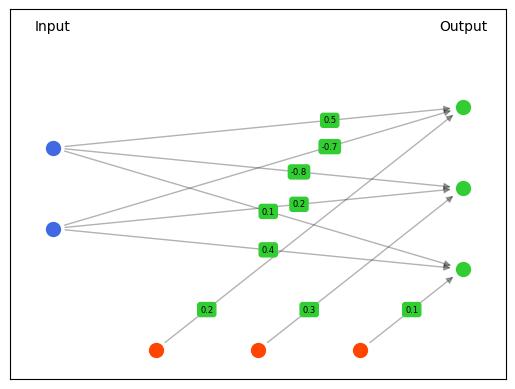

Expected final weights [[[0.1008, 0.3006, 0.1991], [0.402, 0.201, -0.7019], [0.101, -0.799, 0.4987]]]
Final weights
[[[0.10120000000000001, 0.3006, 0.1991], [0.40240000000000004, 0.201, -0.7019], [0.1018, -0.799, 0.4987]]]
Sama dengan expected


In [108]:
# linear_small_lr.JSON
# example
back = FFNN()

back.load_network_from_json("linear_small_lr.json")
back.train()
back.visualize()
print("Expected final weights", back.final_weights)

# print all weights and biass
print("Final weights")
final_weights = []

for layer in back.layers:
    layer_weights = []

    # Append biases of all perceptrons in the current layer to the layer_weights list
    biases = [perceptron.bias for perceptron in layer.perceptrons]
    layer_weights.append(biases)

    # Append the weights for each perceptron to the subsequent rows of layer_weights
    for weight in layer.perceptrons[0].weights:
        layer_weights.append([perceptron.weights[layer.perceptrons[0].weights.index(weight)] for perceptron in layer.perceptrons])

    final_weights.append(layer_weights)
print(final_weights)
print("Sama dengan expected")

Iteration :  1
Batch :  [[3.0, 1.0], [1.0, 2.0]]
len inputs 2
len weights 2
weights [0.4, 0.1]
input [3.0, 1.0]
len inputs 2
len weights 2
weights [0.2, -0.8]
input [3.0, 1.0]
len inputs 2
len weights 2
weights [-0.7, 0.5]
input [3.0, 1.0]
Prediction of input:  [3.0, 1.0]  =  [1.4000000000000004, 0.10000000000000003, -1.3999999999999997]
len inputs 2
len weights 2
weights [0.4, 0.1]
input [1.0, 2.0]
len inputs 2
len weights 2
weights [0.2, -0.8]
input [1.0, 2.0]
len inputs 2
len weights 2
weights [-0.7, 0.5]
input [1.0, 2.0]
Prediction of input:  [1.0, 2.0]  =  [0.7000000000000001, -1.1, 0.5]
Total error =  0.665 treshold =  0.0
Iteration :  2
Batch :  [[3.0, 1.0], [1.0, 2.0]]
len inputs 2
len weights 2
weights [0.6399999999999999, 0.27999999999999997]
input [3.0, 1.0]
len inputs 2
len weights 2
weights [0.30000000000000004, -0.7]
input [3.0, 1.0]
len inputs 2
len weights 2
weights [-0.89, 0.37]
input [3.0, 1.0]
Prediction of input:  [3.0, 1.0]  =  [2.42, 0.5600000000000002, -2.19]
len

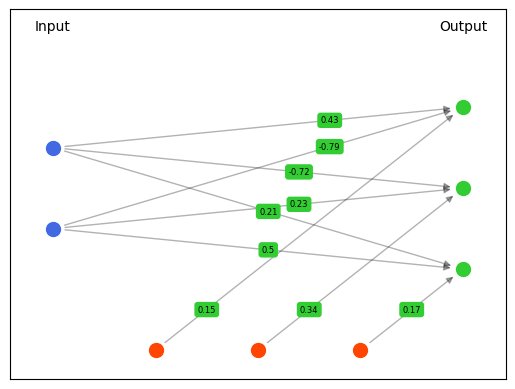

Expected final weights [[[0.166, 0.338, 0.153], [0.502, 0.226, -0.789], [0.214, -0.718, 0.427]]]
Final weights
[[[0.166, 0.33799999999999997, 0.153], [0.502, 0.22599999999999998, -0.7889999999999999], [0.21400000000000002, -0.718, 0.427]]]


In [109]:
# linear_two_iteration.JSON
# example
back = FFNN()

back.load_network_from_json("linear_two_iteration.json")
back.train()
back.visualize()
print("Expected final weights", back.final_weights)

# print all weights and biass
print("Final weights")
final_weights = []

for layer in back.layers:
    layer_weights = []

    # Append biases of all perceptrons in the current layer to the layer_weights list
    biases = [perceptron.bias for perceptron in layer.perceptrons]
    layer_weights.append(biases)

    # Append the weights for each perceptron to the subsequent rows of layer_weights
    for weight in layer.perceptrons[0].weights:
        layer_weights.append([perceptron.weights[layer.perceptrons[0].weights.index(weight)] for perceptron in layer.perceptrons])

    final_weights.append(layer_weights)
print(final_weights)

Iteration :  1
Batch :  [[3.0, 1.0], [1.0, 2.0]]
len inputs 2
len weights 2
weights [0.4, 0.1]
input [3.0, 1.0]
len inputs 2
len weights 2
weights [0.2, -0.8]
input [3.0, 1.0]
len inputs 2
len weights 2
weights [-0.7, 0.5]
input [3.0, 1.0]
Prediction of input:  [3.0, 1.0]  =  [1.4000000000000004, 0.10000000000000003, -1.3999999999999997]
len inputs 2
len weights 2
weights [0.4, 0.1]
input [1.0, 2.0]
len inputs 2
len weights 2
weights [0.2, -0.8]
input [1.0, 2.0]
len inputs 2
len weights 2
weights [-0.7, 0.5]
input [1.0, 2.0]
Prediction of input:  [1.0, 2.0]  =  [0.7000000000000001, -1.1, 0.5]
Total error =  0.665 treshold =  0.0


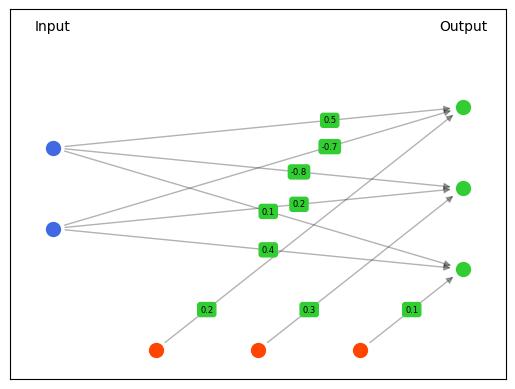

Expected final weights [[[0.1008, 0.3006, 0.1991], [0.402, 0.201, -0.7019], [0.101, -0.799, 0.4987]]]
Final weights
[[[0.10120000000000001, 0.3006, 0.1991], [0.40240000000000004, 0.201, -0.7019], [0.1018, -0.799, 0.4987]]]


In [110]:
# linear_small_lr.JSON
# example
back = FFNN()

back.load_network_from_json("linear_small_lr.json")
back.train()
back.visualize()
print("Expected final weights", back.final_weights)

# print all weights and biass
print("Final weights")
final_weights = []

for layer in back.layers:
    layer_weights = []

    # Append biases of all perceptrons in the current layer to the layer_weights list
    biases = [perceptron.bias for perceptron in layer.perceptrons]
    layer_weights.append(biases)

    # Append the weights for each perceptron to the subsequent rows of layer_weights
    for weight in layer.perceptrons[0].weights:
        layer_weights.append([perceptron.weights[layer.perceptrons[0].weights.index(weight)] for perceptron in layer.perceptrons])

    final_weights.append(layer_weights)
print(final_weights)

Iteration :  1
Batch :  [[-1.0, 0.5], [0.5, -1.0]]
len inputs 2
len weights 2
weights [0.4, 0.7]
input [-1.0, 0.5]
len inputs 2
len weights 2
weights [-0.5, 0.8]
input [-1.0, 0.5]
len inputs 2
len weights 2
weights [0.6, -0.9]
input [-1.0, 0.5]
Prediction of input:  [-1.0, 0.5]  =  [0.04999999999999996, 1.1, 0]
len inputs 2
len weights 2
weights [0.4, 0.7]
input [0.5, -1.0]
len inputs 2
len weights 2
weights [-0.5, 0.8]
input [0.5, -1.0]
len inputs 2
len weights 2
weights [0.6, -0.9]
input [0.5, -1.0]
Prediction of input:  [0.5, -1.0]  =  [0, 0, 1.5]
Total error =  0.14625000000000002 treshold =  0.0


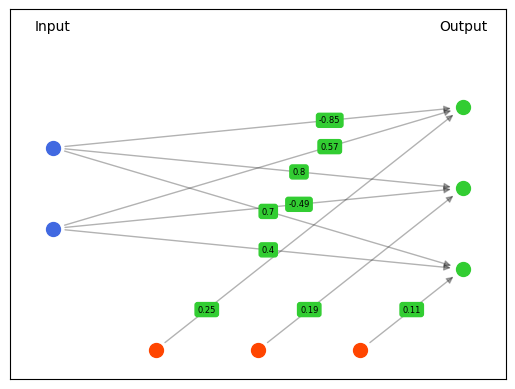

Expected final weights [[[0.105, 0.19, 0.25], [0.395, -0.49, 0.575], [0.7025, 0.795, -0.85]]]
Final weights
[[[0.10500000000000001, 0.19, 0.25], [0.395, -0.49, 0.575], [0.7024999999999999, 0.795, -0.85]]]


In [111]:
# relu.JSON
# example
back = FFNN()

back.load_network_from_json("relu.json")
back.train()
back.visualize()
print("Expected final weights", back.final_weights)

# print all weights and biass
print("Final weights")
final_weights = []

for layer in back.layers:
    layer_weights = []

    # Append biases of all perceptrons in the current layer to the layer_weights list
    biases = [perceptron.bias for perceptron in layer.perceptrons]
    layer_weights.append(biases)

    # Append the weights for each perceptron to the subsequent rows of layer_weights
    for weight in layer.perceptrons[0].weights:
        layer_weights.append([perceptron.weights[layer.perceptrons[0].weights.index(weight)] for perceptron in layer.perceptrons])

    final_weights.append(layer_weights)
print(final_weights)

Iteration :  1
Batch :  [[0.0, 0.0], [0.0, 0.1]]
len inputs 2
len weights 2
weights [0.4, 0.9]
input [0.0, 0.0]
len inputs 2
len weights 2
weights [0.5, 0.1]
input [0.0, 0.0]
Prediction of input:  [0.0, 0.0]  =  [0.52497918747894, 0.549833997312478]
len inputs 2
len weights 2
weights [0.4, 0.9]
input [0.0, 0.1]
len inputs 2
len weights 2
weights [0.5, 0.1]
input [0.0, 0.1]
Prediction of input:  [0.0, 0.1]  =  [0.5473576181430894, 0.5523079095743253]
Total error =  0.4465929462986903 treshold =  0.1


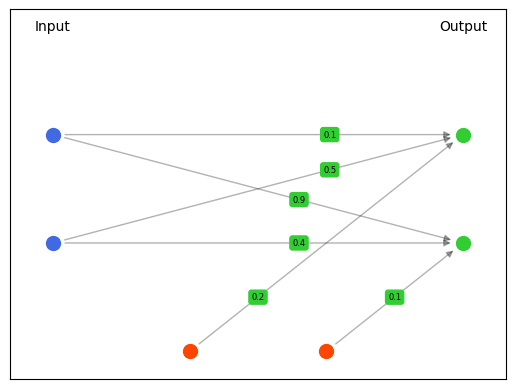

Expected final weights [[[0.7125, -1.1742], [2.3583, -0.2848], [0.1112, -1.1396]]]
Final weights
[[[0.10058427660450465, 0.19763864183089194], [0.4, 0.5], [0.9010509079190674, 0.09871939814339445]]]


In [112]:
# sigmoid.JSON
# example
back = FFNN()

back.load_network_from_json("sigmoid.json")
back.train()
back.visualize()
print("Expected final weights", back.final_weights)

# print all weights and biass
print("Final weights")
final_weights = []

for layer in back.layers:
    layer_weights = []

    # Append biases of all perceptrons in the current layer to the layer_weights list
    biases = [perceptron.bias for perceptron in layer.perceptrons]
    layer_weights.append(biases)

    # Append the weights for each perceptron to the subsequent rows of layer_weights
    for weight in layer.perceptrons[0].weights:
        layer_weights.append([perceptron.weights[layer.perceptrons[0].weights.index(weight)] for perceptron in layer.perceptrons])

    final_weights.append(layer_weights)
print(final_weights)

Iteration :  1
Batch :  [[0.0, 0.0], [0.0, 0.1]]
len inputs 2
len weights 2
weights [0.2, 0.35]
input [0.0, 0.0]
len inputs 2
len weights 2
weights [0.3, 0.35]
input [0.0, 0.0]
Prediction of input:  [0.0, 0.0]  =  [0.5374298453437496, 0.5621765008857981]
len inputs 2
len weights 2
weights [0.2, 0.35]
input [0.0, 0.1]
len inputs 2
len weights 2
weights [0.3, 0.35]
input [0.0, 0.1]
Prediction of input:  [0.0, 0.1]  =  [0.5461185410457796, 0.5707716118944918]
Batch :  [[1.0, 0.0], [1.0, 1.0]]
len inputs 2
len weights 2
weights [0.2, 0.35105413307410394]
input [1.0, 0.0]
len inputs 2
len weights 2
weights [0.3, 0.3486832564748944]
input [1.0, 0.0]
Prediction of input:  [1.0, 0.0]  =  [0.5867045639967079, 0.6334292875616546]
len inputs 2
len weights 2
weights [0.2, 0.35105413307410394]
input [1.0, 1.0]
len inputs 2
len weights 2
weights [0.3, 0.3486832564748944]
input [1.0, 1.0]
Prediction of input:  [1.0, 1.0]  =  [0.6685009446065185, 0.71005273609796]
Total error =  1.0855392516599112 tre

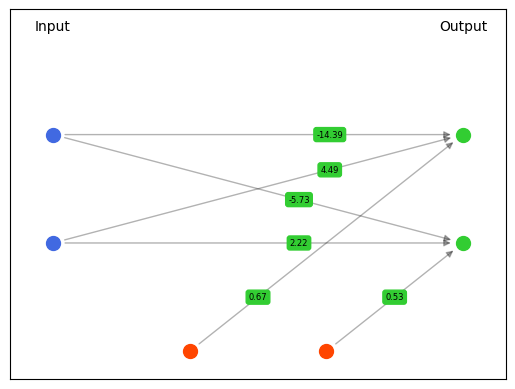

Expected final weights None
Final weights
[[[0.5327192296862032, 0.6654544744190337], [2.216678851112265, 4.487071499001865], [-5.728858567910599, -14.3860766895132]]]


In [113]:
# sigmoid_minibatch_GD.JSON
# example
back = FFNN()

back.load_network_from_json("sigmoid_mini_batch_GD.json")
back.train()
back.visualize()
print("Expected final weights", back.final_weights)

# print all weights and biass
print("Final weights")
final_weights = []

for layer in back.layers:
    layer_weights = []

    # Append biases of all perceptrons in the current layer to the layer_weights list
    biases = [perceptron.bias for perceptron in layer.perceptrons]
    layer_weights.append(biases)

    # Append the weights for each perceptron to the subsequent rows of layer_weights
    for weight in layer.perceptrons[0].weights:
        layer_weights.append([perceptron.weights[layer.perceptrons[0].weights.index(weight)] for perceptron in layer.perceptrons])

    final_weights.append(layer_weights)
print(final_weights)

Iteration :  1
Batch :  [[0.0, 0.0], [0.0, 0.1]]
len inputs 2
len weights 2
weights [0.2, 0.35]
input [0.0, 0.0]
len inputs 2
len weights 2
weights [0.3, 0.35]
input [0.0, 0.0]
Prediction of input:  [0.0, 0.0]  =  [0.5374298453437496, 0.5621765008857981]
len inputs 2
len weights 2
weights [0.2, 0.35]
input [0.0, 0.1]
len inputs 2
len weights 2
weights [0.3, 0.35]
input [0.0, 0.1]
Prediction of input:  [0.0, 0.1]  =  [0.5461185410457796, 0.5707716118944918]
Batch :  [[1.0, 0.0], [1.0, 1.0]]
len inputs 2
len weights 2
weights [0.2, 0.35105413307410394]
input [1.0, 0.0]
len inputs 2
len weights 2
weights [0.3, 0.3486832564748944]
input [1.0, 0.0]
Prediction of input:  [1.0, 0.0]  =  [0.5867045639967079, 0.6334292875616546]
len inputs 2
len weights 2
weights [0.2, 0.35105413307410394]
input [1.0, 1.0]
len inputs 2
len weights 2
weights [0.3, 0.3486832564748944]
input [1.0, 1.0]
Prediction of input:  [1.0, 1.0]  =  [0.6685009446065185, 0.71005273609796]
Total error =  1.0855392516599112 tre

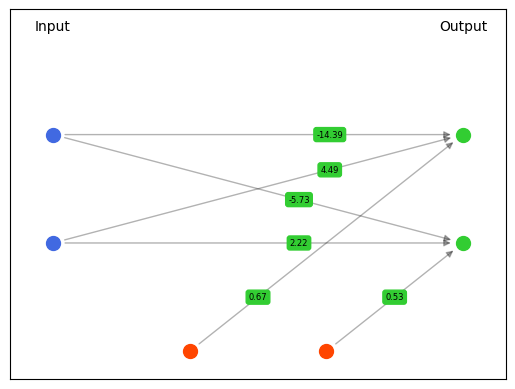

Expected final weights None
Final weights
[[[0.5327192296862032, 0.6654544744190337], [2.216678851112265, 4.487071499001865], [-5.728858567910599, -14.3860766895132]]]


In [114]:
# sigmoid_stochastic_GD.JSON
# example
back = FFNN()

back.load_network_from_json("sigmoid_stochastic_GD.json")
back.train()
back.visualize()
print("Expected final weights", back.final_weights)

# print all weights and biass
print("Final weights")
final_weights = []

for layer in back.layers:
    layer_weights = []

    # Append biases of all perceptrons in the current layer to the layer_weights list
    biases = [perceptron.bias for perceptron in layer.perceptrons]
    layer_weights.append(biases)

    # Append the weights for each perceptron to the subsequent rows of layer_weights
    for weight in layer.perceptrons[0].weights:
        layer_weights.append([perceptron.weights[layer.perceptrons[0].weights.index(weight)] for perceptron in layer.perceptrons])

    final_weights.append(layer_weights)
print(final_weights)

Iteration :  1
Batch :  [[-1.0, 0.5], [0.5, -1.0]]
Prediction of input:  [-1.0, 0.5]  =  [0.259225100817846, 0.740774899182154]
Prediction of input:  [0.5, -1.0]  =  [0.610639233949222, 0.38936076605077796]
Total error =  2.2933074256150983 treshold =  0.0


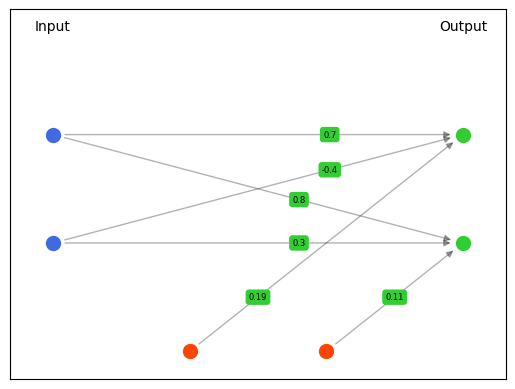

Expected final weights [[[0.11301357, 0.18698643], [0.29539055, -0.39539055], [0.79810267, 0.70189733]]]
Final weights
[[[0.1130135665232932, 0.18698643347670682], [0.29539054838432355, -0.3953905483843235], [0.7981026683540299, 0.7018973316459701]]]


In [115]:
# softmax.JSON
# example
back = FFNN()

back.load_network_from_json("softmax.json")
back.train()
back.visualize()
print("Expected final weights", back.final_weights)

# print all weights and biass
print("Final weights")
final_weights = []

for layer in back.layers:
    layer_weights = []

    # Append biases of all perceptrons in the current layer to the layer_weights list
    biases = [perceptron.bias for perceptron in layer.perceptrons]
    layer_weights.append(biases)

    # Append the weights for each perceptron to the subsequent rows of layer_weights
    for weight in layer.perceptrons[0].weights:
        layer_weights.append([perceptron.weights[layer.perceptrons[0].weights.index(weight)] for perceptron in layer.perceptrons])

    final_weights.append(layer_weights)
print(final_weights)

Iteration :  1
Batch :  [[-1.0]]
Prediction of input:  [-1.0]  =  [0.19781611144141822, 0.8021838885585818]
Total error =  0.22041740991845085 treshold =  0.225
Total error =  0.22041740991845085  <  0.225  stop training


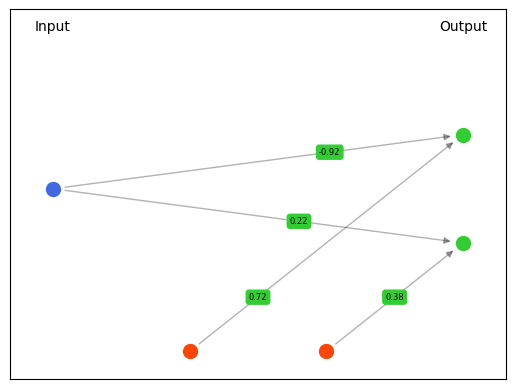

Expected final weights [[[0.4, 0.7], [0.2, -0.9]]]
Final weights
[[[0.3802183888558582, 0.7197816111441417], [0.21978161114414183, -0.9197816111441418]]]


In [116]:
# softmax_error_only.JSON
# example
back = FFNN()

back.load_network_from_json("softmax_error_only.json")
back.train()
back.visualize()
print("Expected final weights", back.final_weights)

# print all weights and biass
print("Final weights")
final_weights = []

for layer in back.layers:
    layer_weights = []

    # Append biases of all perceptrons in the current layer to the layer_weights list
    biases = [perceptron.bias for perceptron in layer.perceptrons]
    layer_weights.append(biases)

    # Append the weights for each perceptron to the subsequent rows of layer_weights
    for weight in layer.perceptrons[0].weights:
        layer_weights.append([perceptron.weights[layer.perceptrons[0].weights.index(weight)] for perceptron in layer.perceptrons])

    final_weights.append(layer_weights)
print(final_weights)

0.0
Iteration :  1
Batch :  [[0.0]]
len inputs 1
len weights 1
weights [0.0]
input [0.0]
len inputs 1
len weights 1
weights [0.0]
input [0.0]
Prediction of input:  [0.0]  =  [0.5, 0.5]
Total error =  0.25 treshold =  0.25
Iteration :  2
Batch :  [[0.0]]
len inputs 1
len weights 1
weights [0.0]
input [0.0]
len inputs 1
len weights 1
weights [0.0]
input [0.0]
Prediction of input:  [0.0]  =  [0.495, 0.505]
Total error =  0.245025 treshold =  0.25
Total error =  0.245025  <  0.25  stop training


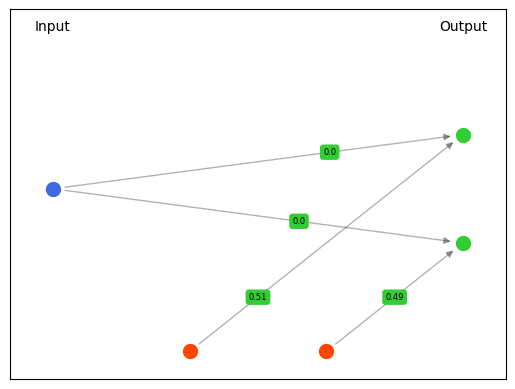

Expected final weights [[[0.5, 0.5], [0.0, 0.0]]]
Final weights
[[[0.49005, 0.50995], [0.0, 0.0]]]


In [117]:
# sse_only.JSON
# example
back = FFNN()

back.load_network_from_json("sse_only.json")
print(back.error)
back.train()
back.visualize()
print("Expected final weights", back.final_weights)

# print all weights and biass
print("Final weights")
final_weights = []

for layer in back.layers:
    layer_weights = []

    # Append biases of all perceptrons in the current layer to the layer_weights list
    biases = [perceptron.bias for perceptron in layer.perceptrons]
    layer_weights.append(biases)

    # Append the weights for each perceptron to the subsequent rows of layer_weights
    for weight in layer.perceptrons[0].weights:
        layer_weights.append([perceptron.weights[layer.perceptrons[0].weights.index(weight)] for perceptron in layer.perceptrons])

    final_weights.append(layer_weights)
print(final_weights)

0.0
Iteration :  1
Batch :  [[-1.0, 0.5], [0.5, -1.0]]
len inputs 2
len weights 2
weights [0.4, 0.7]
input [-1.0, 0.5]
len inputs 2
len weights 2
weights [-0.5, 0.8]
input [-1.0, 0.5]
len inputs 2
len weights 2
weights [0.4, 0.7]
input [0.04999999999999996, 1.1]
len inputs 2
len weights 2
weights [-0.5, 0.8]
input [0.04999999999999996, 1.1]
Prediction of input:  [-1.0, 0.5]  =  [0.89, 1.0550000000000002]
len inputs 2
len weights 2
weights [0.4, 0.7]
input [0.5, -1.0]
len inputs 2
len weights 2
weights [-0.5, 0.8]
input [0.5, -1.0]
len inputs 2
len weights 2
weights [0.4, 0.7]
input [-0.3999999999999999, -0.8500000000000001]
len inputs 2
len weights 2
weights [-0.5, 0.8]
input [-0.3999999999999999, -0.8500000000000001]
Prediction of input:  [0.5, -1.0]  =  [0, 0]
Total error =  0.8185625000000001 treshold =  0.0


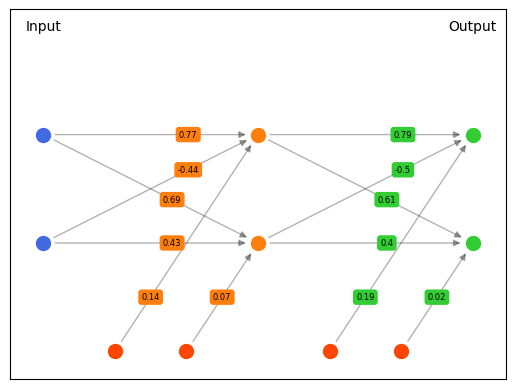

Expected final weights [[[0.07115, 0.1403], [0.42885, -0.4403], [0.685575, 0.77015]], [[0.121, 0.2045], [0.35605, -0.504275], [0.5281, 0.78545]]]
Final weights
[[[0.07115, 0.1403], [0.42885, -0.44029999999999997], [0.6855749999999999, 0.77015]], [[0.02099999999999999, 0.1945], [0.39605, -0.500275], [0.6131, 0.79395]]]


In [118]:
# mlp.JSON
# example
back = FFNN()

back.load_network_from_json("mlp.json")
print(back.error)
back.train()
back.visualize()
print("Expected final weights", back.final_weights)

# print all weights and biass
print("Final weights")
final_weights = []

for layer in back.layers:
    layer_weights = []

    # Append biases of all perceptrons in the current layer to the layer_weights list
    biases = [perceptron.bias for perceptron in layer.perceptrons]
    layer_weights.append(biases)

    # Append the weights for each perceptron to the subsequent rows of layer_weights
    for weight in layer.perceptrons[0].weights:
        layer_weights.append([perceptron.weights[layer.perceptrons[0].weights.index(weight)] for perceptron in layer.perceptrons])

    final_weights.append(layer_weights)
print(final_weights)

# Implementasi save network to JSON

Iteration :  1
Batch :  [[-1.0, 0.5], [0.5, -1.0]]
len inputs 2
len weights 2
weights [0.4, 0.7]
input [-1.0, 0.5]
len inputs 2
len weights 2
weights [-0.5, 0.8]
input [-1.0, 0.5]
len inputs 2
len weights 2
weights [0.4, 0.7]
input [0.04999999999999996, 1.1]
len inputs 2
len weights 2
weights [-0.5, 0.8]
input [0.04999999999999996, 1.1]
Prediction of input:  [-1.0, 0.5]  =  [0.89, 1.0550000000000002]
len inputs 2
len weights 2
weights [0.4, 0.7]
input [0.5, -1.0]
len inputs 2
len weights 2
weights [-0.5, 0.8]
input [0.5, -1.0]
len inputs 2
len weights 2
weights [0.4, 0.7]
input [-0.3999999999999999, -0.8500000000000001]
len inputs 2
len weights 2
weights [-0.5, 0.8]
input [-0.3999999999999999, -0.8500000000000001]
Prediction of input:  [0.5, -1.0]  =  [0, 0]
Total error =  0.8185625000000001 treshold =  0.0


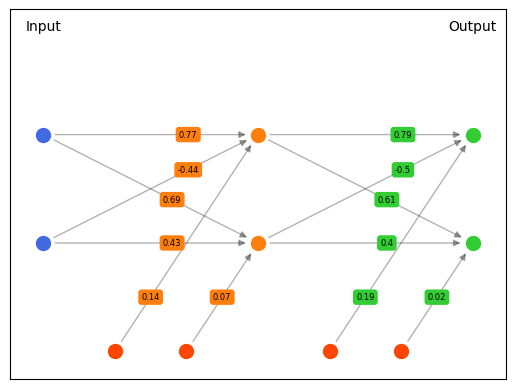

Expected final weights [[[0.07115, 0.1403], [0.42885, -0.4403], [0.685575, 0.77015]], [[0.121, 0.2045], [0.35605, -0.504275], [0.5281, 0.78545]]]
Final weights
[[[0.07115, 0.1403], [0.42885, -0.44029999999999997], [0.6855749999999999, 0.77015]], [[0.02099999999999999, 0.1945], [0.39605, -0.500275], [0.6131, 0.79395]]]
SAVING TO JSON
Iteration :  1
Batch :  [[-1.0, 0.5], [0.5, -1.0]]
len inputs 2
len weights 2
weights [0.42885, 0.6855749999999999]
input [-1.0, 0.5]
len inputs 2
len weights 2
weights [-0.44029999999999997, 0.77015]
input [-1.0, 0.5]
len inputs 2
len weights 2
weights [0.39605, 0.6131]
input [-0.014912500000000037, 0.965675]
len inputs 2
len weights 2
weights [-0.500275, 0.79395]
input [-0.014912500000000037, 0.965675]
Prediction of input:  [-1.0, 0.5]  =  [0.6071492468749999, 0.9686580171875]
len inputs 2
len weights 2
weights [0.42885, 0.6855749999999999]
input [0.5, -1.0]
len inputs 2
len weights 2
weights [-0.44029999999999997, 0.77015]
input [0.5, -1.0]
len inputs 2


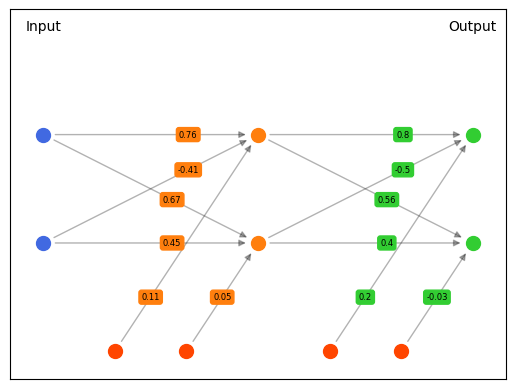

Final weights
[[[0.07115, 0.1403], [0.42885, -0.44029999999999997], [0.6855749999999999, 0.77015]], [[0.02099999999999999, 0.1945], [0.39605, -0.500275], [0.6131, 0.79395]]]


In [119]:
# mlp.JSON
# example
back = FFNN()

back.load_network_from_json("mlp.json")
back.train()
back.visualize()
print("Expected final weights", back.final_weights)

# print all weights and biass
print("Final weights")
final_weights = []

for layer in back.layers:
    layer_weights = []

    # Append biases of all perceptrons in the current layer to the layer_weights list
    biases = [perceptron.bias for perceptron in layer.perceptrons]
    layer_weights.append(biases)

    # Append the weights for each perceptron to the subsequent rows of layer_weights
    for weight in layer.perceptrons[0].weights:
        layer_weights.append([perceptron.weights[layer.perceptrons[0].weights.index(weight)] for perceptron in layer.perceptrons])

    final_weights.append(layer_weights)
print(final_weights)

print ("SAVING TO JSON")
back.save_network_to_json("mlp_saved.json")

new = FFNN()
new.load_network_from_json("mlp_saved.json")
new.train()
new.visualize()
# print all weights and biass
print("Final weights")
final_weights = []

for layer in back.layers:
    layer_weights = []

    # Append biases of all perceptrons in the current layer to the layer_weights list
    biases = [perceptron.bias for perceptron in layer.perceptrons]
    layer_weights.append(biases)

    # Append the weights for each perceptron to the subsequent rows of layer_weights
    for weight in layer.perceptrons[0].weights:
        layer_weights.append([perceptron.weights[layer.perceptrons[0].weights.index(weight)] for perceptron in layer.perceptrons])

    final_weights.append(layer_weights)
print(final_weights)



# pembelajaran dataset iris (unfinished)

4 3
num:  0
weights:  [[], [], [], []]
num_of_prev_perceptrons:  4
weights:  [[0.357107220593879, -0.05829930755856649, -0.38550057840028673, -0.2077984311944061], [-0.70599905784718, -0.41198365783968227, 0.5015078863894478, -0.03809765693159983], [0.38621232669287653, -0.5151839017375588, -0.5244346747256379, -0.5191338291388836], [0.9391333941389497, 0.8145369684987909, -0.10060378217638832, 0.17344159069440845]]
num_of_prev_perceptrons:  4
weights:  [[-0.9742222111578651, -0.12853504141467376, 0.719146856530334, -0.8605737087502459], [0.7406098666526275, 0.3433675344711875, 0.06879766904380058, -0.004388349416347692], [-0.6697936425261448, -0.10235145974301108, -0.5395441830391365, 0.9567170009056813], [0.41537639732300047, 0.2066034979099034, 0.07956795178615472, 0.5568376067581271]]
num_of_prev_perceptrons:  4
weights:  [[-0.7408448845828506, 0.2429948055519946, 0.7007303327314587, 0.6711893996655232], [0.5557550699387328, 0.24462800598565426, 0.9915281565448215, -0.1038298778169

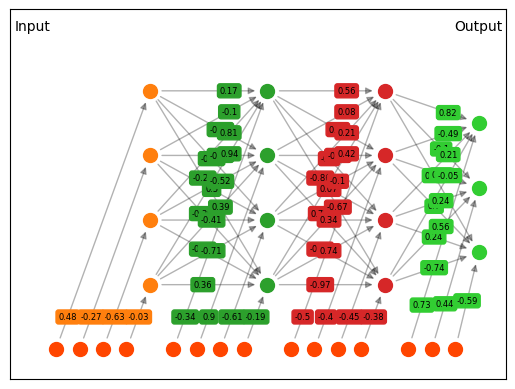

In [129]:
# train this model with iris dataset
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.datasets import load_iris
from sklearn.metrics import accuracy_score, f1_score

dataset = load_iris()

X = dataset.data
Y = dataset.target

input_size = 4
output_size = len(np.unique(Y))
print(input_size, output_size)


back = FFNN()
back.set_inputs(X)
back.set_target(Y)
back.add_layer(4, "linear")
back.add_layer(4, "linear")
back.add_layer(4, "linear")
back.add_layer(3, "linear")
back.set_parameters(input_size,Y, 0.01, 20, 100, "max_iteration", 0)

#print one perceptron on the first layer
print(back.layers[0].perceptrons[0].weights)


back.visualize()




# perbandingan dengan menggunakan MLP sklearn

In [ ]:
pip install scikit-learn


You should consider upgrading via the '/usr/local/bin/python3 -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


In [124]:


from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.datasets import load_iris

dataset = load_iris()
X = dataset.data
Y = dataset.target

clf = MLPClassifier(
    hidden_layer_sizes=(4,2),
    activation="identity", 
    solver="sgd", 
    batch_size=20, 
    learning_rate_init=0.01, 
    learning_rate="constant", 
    max_iter=100
)
clf.fit(X, Y)

weightArr = clf.coefs_
biasArr = clf.intercepts_

print("Jumlah layer: {}".format(clf.n_layers_))
print("Jumlah iterasi: {}".format(clf.n_iter_))
print("Jumlah fitur: {}".format(clf.n_features_in_))
print("Jumlah output: {}".format(clf.n_outputs_))

# Print array weight dan bias untuk setiap layer
for i in range(len(weightArr)):
    print("Layer ke-{}: ".format(i+1))
    print("Weight: {}".format(weightArr[i]))
    print("Bias: {}".format(biasArr[i]))
    print()






Jumlah layer: 4
Jumlah iterasi: 66
Jumlah fitur: 4
Jumlah output: 3
Layer ke-1: 
Weight: [[ 0.25493766 -0.07515507 -0.88624169 -0.72552308]
 [ 0.35357722  0.12102536 -0.86759725 -0.96266214]
 [-0.48998476 -0.79610847  1.48907896  1.44519839]
 [ 0.34422031  0.66224967  0.63604672  1.90009974]]
Bias: [-0.18950146 -1.07777167 -0.13567116 -0.66434331]

Layer ke-2: 
Weight: [[-0.06307326  0.02422788]
 [-0.6676873  -0.86109678]
 [ 0.89259019 -0.83719387]
 [ 1.43414952 -1.27778768]]
Bias: [ 0.55171898 -0.40327707]

Layer ke-3: 
Weight: [[-1.0455105   0.47253127  1.08757484]
 [ 0.49239231  0.8647899  -0.99825465]]
Bias: [-0.93661165  0.65908046 -1.18735938]

